In [20]:
# https://www.sc-best-practices.org/conditions/gsea_pathway.html#id380
# Kang HM, Subramaniam M, Targ S, et al. Multiplexed droplet single-cell RNA-sequencing using natural genetic variation
#   Nat Biotechnol. 2020 Nov;38(11):1356]. Nat Biotechnol. 2018;36(1):89-94. doi:10.1038/nbt.4042

In [1]:
%load_ext autoreload
%autoreload 2

import scanpy as sc
import tensorflow as tf
from tensorflow.keras.models import Model
# from ivae_scorer.datasets import load_kang
from tensorflow.keras import callbacks
# from ivae_scorer.utils import set_all_seeds
# from ivae_scorer.bio import get_adj_matrices, sync_gexp_adj, build_hipathia_renamers
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import minmax_scale
import matplotlib.pyplot as plt
import seaborn as sns
import dotenv
from pathlib import Path

# project_path = Path(dotenv.find_dotenv()).parent
project_path = Path(dotenv.find_dotenv()).resolve().parent
results_path = project_path.joinpath("results")
results_path.mkdir(exist_ok=True, parents=True)
data_path = project_path.joinpath("data")
data_path.mkdir(exist_ok=True, parents=True)
figs_path = results_path.joinpath("figs")
figs_path.mkdir(exist_ok=True, parents=True)
tables_path = results_path.joinpath("tables")
tables_path.mkdir(exist_ok=True, parents=True)

# set_all_seeds(seed=42)

tf.config.experimental.enable_op_determinism()

sc.set_figure_params(dpi=300, color_map="inferno")
sc.settings.verbosity = 1
sc.logging.print_header()

import os, sys
here = os.path.dirname('__file__')
sys.path.append(os.path.join(here, '..'))
from ivae_scorer.datasets import load_kang
from ivae_scorer.utils import set_all_seeds
from ivae_scorer.bio import get_adj_matrices, sync_gexp_adj, build_hipathia_renamers
set_all_seeds(seed=42)

2024-06-11 17:31:41.685617: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
/Users/pelingundogdu/opt/anaconda3/envs/env_ivae/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.9.3 anndata==0.9.1 umap==0.5.3 numpy==1.23.5 scipy==1.10.1 pandas==2.0.1 scikit-learn==1.2.2 statsmodels==0.13.5 python-igraph==0.10.3 pynndescent==0.5.10


ModuleNotFoundError: No module named 'ivae_scorer'

In [3]:
adata = load_kang(data_folder=data_path, normalize=True, n_genes=4000)

In [4]:
x_trans = adata.to_df()

In [5]:
circuit_adj, circuit_to_pathway_adj = get_adj_matrices(
    gene_list=x_trans.columns.to_list()
)

circuit_adj.head()

circuit,P-hsa03320-62,P-hsa03320-45,P-hsa03320-43,P-hsa03320-23,P-hsa03320-32,P-hsa03320-8,P-hsa03320-7,P-hsa03320-9,P-hsa03320-39,P-hsa03320-38,...,P-hsa05164-41.42,P-hsa05164-47,P-hsa05164-53,P-hsa05164-65.66,P-hsa05164-68,P-hsa05164-70,P-hsa05164-77,P-hsa05164-78,P-hsa05164-90,P-hsa05164-99
symbol,,,,,,,,,,,,,,,,,,,,,
AKT3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
TANK,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
BCL2L11,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
SH2B3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
FRAT1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [6]:
x_trans, circuit_adj = sync_gexp_adj(gexp=x_trans, adj=circuit_adj)
x_trans.shape, circuit_adj.shape, circuit_to_pathway_adj.shape

((24673, 1820), (1820, 1221), (1221, 93))

In [7]:
obs = adata.obs.copy()

x_train, x_test = train_test_split(
    x_trans.apply(minmax_scale),
    test_size=0.33,
    stratify=obs["cell_type"],
    random_state=42,
)
x_train = x_train.astype("float32")
x_test = x_test.astype("float32")

In [8]:
from ivae_scorer.models import build_kegg_vae

vae, encoder, decoder = build_kegg_vae(
    circuits=circuit_adj, pathways=circuit_to_pathway_adj
)

2024-06-11 17:36:11.648761: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [10]:
batch_size = 32

callback = callbacks.EarlyStopping(
    monitor="val_loss",  # Stop training when `val_loss` is no longer improving
    min_delta=1e-1,  # "no longer improving" being defined as "no better than 1e-5 less"
    patience=30,  # "no longer improving" being further defined as "for at least 3 epochs"
    verbose=0,
)

history = vae.fit(
    x_train.values,
    shuffle=True,
    verbose=0,
    epochs=100
    batch_size=batch_size,
    callbacks=[callback],
    validation_data=(x_test.values, None),
)

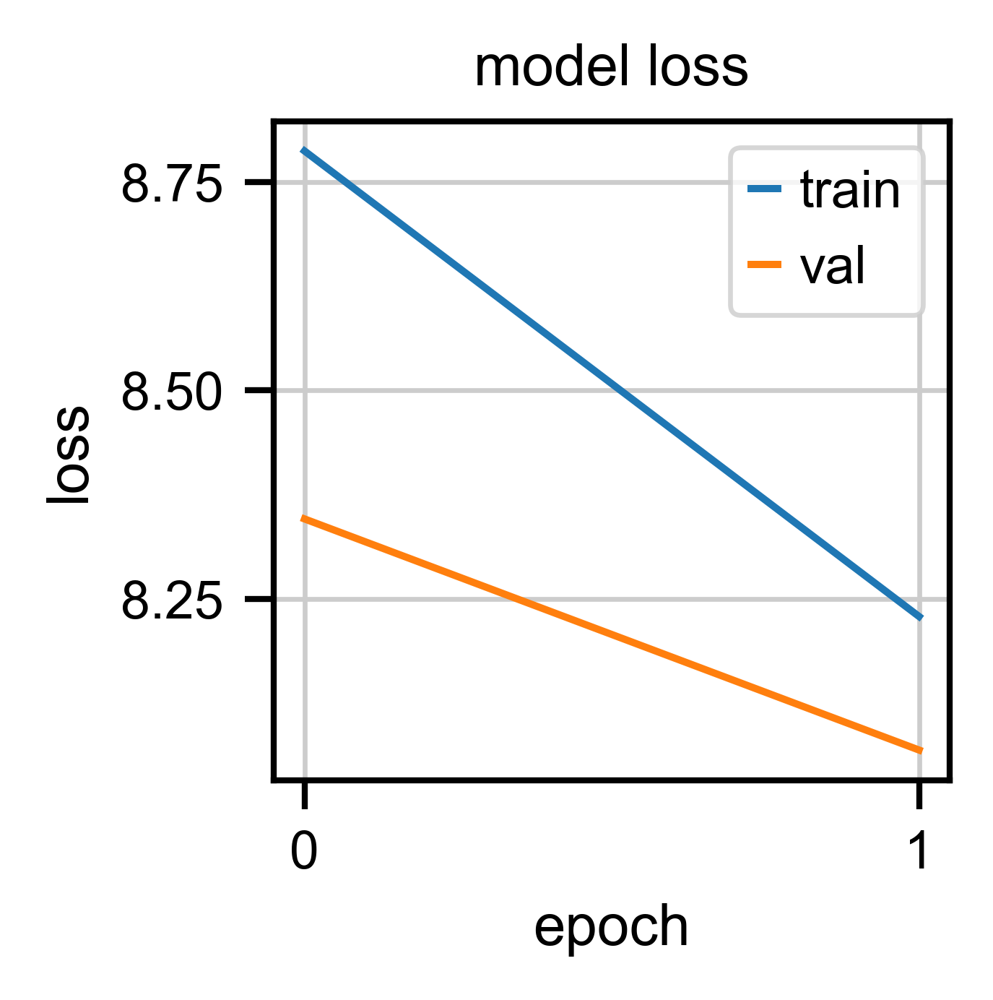

In [11]:
with sns.plotting_context("paper"):
    history.history.keys()
    # summarize history for loss
    plt.figure(figsize=(2, 2))
    plt.plot(history.history["loss"])
    plt.plot(history.history["val_loss"])
    plt.title("model loss")
    plt.ylabel("loss")
    plt.xlabel("epoch")
    plt.legend(["train", "val"], loc="upper right")

In [12]:
import pandas as pd

x_train_encoded = encoder.predict(x_train, batch_size=batch_size)[0]
x_train_encoded = pd.DataFrame(x_train_encoded, index=x_train.index)

adata = sc.AnnData(X=x_train_encoded)
adata.obs = obs.loc[x_train.index]

# sc.pp.log1p(adata)
sc.pp.neighbors(adata, use_rep="X", random_state=42)
sc.tl.leiden(adata, random_state=42)
sc.tl.umap(adata, random_state=42)

517/517 [==============================] - 6s 10ms/step


/Users/pelingundogdu/opt/anaconda3/envs/env_ivae/lib/python3.10/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [13]:
layer_outputs = [layer.output for layer in encoder.layers]
activation_model = Model(inputs=encoder.input, outputs=layer_outputs)

In [14]:
# circuit activity extracted from first layer
layer_id = 1

circuit_renamer, pathway_renamer, circuit_to_effector = build_hipathia_renamers()

if layer_id == 1:
    entitie_names = circuit_adj.rename(columns=circuit_renamer).columns

x_train_encoded = activation_model.predict(x_train, batch_size=batch_size)[layer_id]
x_train_encoded = pd.DataFrame(
    x_train_encoded, index=x_train.index, columns=entitie_names
)

entities_adata = sc.AnnData(X=x_train_encoded.abs())
entities_adata.obs = obs.loc[x_train.index]

# sc.pp.log1p(adata)
sc.pp.neighbors(entities_adata, use_rep="X", random_state=42)
sc.tl.leiden(entities_adata, random_state=42)
sc.tl.umap(entities_adata, random_state=42)

517/517 [==============================] - 8s 15ms/step


In [15]:
method = "wilcoxon"
sc.tl.rank_genes_groups(
    entities_adata, "condition", refrence="control", key_added=method, method=method
)

result = entities_adata.uns[method]
groups = ["stimulated"]
dacs = pd.DataFrame(
    {
        group + "_" + key: result[key][group]
        for group in groups
        for key in ["names", "scores", "pvals", "pvals_adj", "logfoldchanges"]
    }
)

dacs.head(10)

,stimulated_names,stimulated_scores,stimulated_pvals,stimulated_pvals_adj,stimulated_logfoldchanges
0,RIG-I-like receptor signaling pathway: MAVS TM...,102.823471,0.0,0.0,2.149006
1,RIG-I-like receptor signaling pathway: MAPK14,96.290794,0.0,0.0,2.141870
2,RIG-I-like receptor signaling pathway: MAPK8,89.741913,0.0,0.0,1.770364
3,RIG-I-like receptor signaling pathway: CHUK IK...,84.207779,0.0,0.0,1.931478
4,Cytosolic DNA-sensing pathway: TBK1,68.526726,0.0,0.0,1.272382
5,Influenza A: IRF7,64.557899,0.0,0.0,2.468597
6,Cytosolic DNA-sensing pathway: IKBKE,56.620274,0.0,0.0,1.180267
7,RIG-I-like receptor signaling pathway: IRF7,56.591232,0.0,0.0,1.040419
8,Toll-like receptor signaling pathway: CXCL10,51.399910,0.0,0.0,1.847300
9,FoxO signaling pathway: TNFSF10,46.000618,0.0,0.0,1.056229


In [17]:
dacs_to_write = dacs.head(10).copy()
dacs_to_write.columns = dacs_to_write.columns.str.replace("stimulated_", "")
dacs_to_write = dacs_to_write.rename(columns={"names": "pathways"})
dacs_to_write = dacs_to_write.drop("pvals", axis=1)

dacs_to_write["pathways"] = (
    dacs_to_write["pathways"]
    .str.replace("signaling pathway", "")
    .str.replace(" sathway", "")
    .str.replace(" :", ":")
)
dacs_to_write.to_latex(
    tables_path.joinpath("ivae_scorer_kegg.tex"),
    float_format="%.2f",
    index=False,
    escape=True,
)

dacs_to_write

,pathways,scores,pvals_adj,logfoldchanges
0,RIG-I-like receptor: MAVS TMEM173,102.823471,0.0,2.149006
1,RIG-I-like receptor: MAPK14,96.290794,0.0,2.141870
2,RIG-I-like receptor: MAPK8,89.741913,0.0,1.770364
3,RIG-I-like receptor: CHUK IKBKB IKBKG,84.207779,0.0,1.931478
4,Cytosolic DNA-sensing pathway: TBK1,68.526726,0.0,1.272382
5,Influenza A: IRF7,64.557899,0.0,2.468597
6,Cytosolic DNA-sensing pathway: IKBKE,56.620274,0.0,1.180267
7,RIG-I-like receptor: IRF7,56.591232,0.0,1.040419
8,Toll-like receptor: CXCL10,51.399910,0.0,1.847300
9,FoxO: TNFSF10,46.000618,0.0,1.056229


In [18]:
dacs_top = dacs["stimulated_names"][:10]
# dacs_top = dacs_top[dacs_top.str.contains("interferon|ifn", case=False)]
dacs_top

0    RIG-I-like receptor signaling pathway: MAVS TM...
1        RIG-I-like receptor signaling pathway: MAPK14
2         RIG-I-like receptor signaling pathway: MAPK8
3    RIG-I-like receptor signaling pathway: CHUK IK...
4                  Cytosolic DNA-sensing pathway: TBK1
5                                    Influenza A: IRF7
6                 Cytosolic DNA-sensing pathway: IKBKE
7          RIG-I-like receptor signaling pathway: IRF7
8         Toll-like receptor signaling pathway: CXCL10
9                      FoxO signaling pathway: TNFSF10
Name: stimulated_names, dtype: object

In [19]:
names_to_plot = (
    dacs_top.str.replace("signaling pathway", "")
    .str.replace(" pathway", "")
    .str.replace(" :", ":")
    .tolist()
)

adata.obsm["pathways"] = x_train_encoded.abs()
adata.obs[names_to_plot] = adata.obsm["pathways"][dacs_top]

In [37]:
sc.pl.umap(
    adata,
    color=["condition", "cell_type"] + names_to_plot,
    frameon=False,
    ncols=2,
    wspace=0.3,
    show=False,
)

plt.savefig(figs_path.joinpath("ivae_scorer_kegg_ifn_top10.pdf"), bbox_inches="tight")

/home/carlos/github/ivae_scorer/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/carlos/github/ivae_scorer/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/home/carlos/github/ivae_scorer/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/carlos/github/ivae_scorer/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


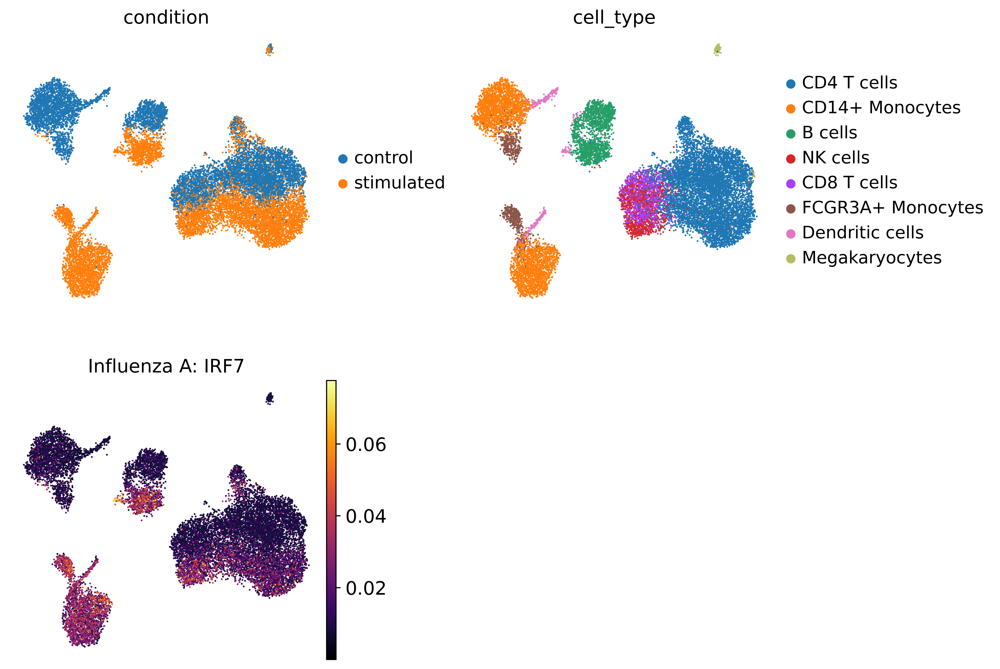

In [45]:
ifn_circuits = (
    dacs[dacs.stimulated_names.str.contains("influenza", case=False)]
    .loc[(dacs.stimulated_pvals_adj < 0.05) & (dacs.stimulated_logfoldchanges > 1)]
    .stimulated_names.tolist()
)
adata.obs[ifn_circuits] = adata.obsm["pathways"][ifn_circuits]

sc.pl.umap(
    adata,
    color=["condition", "cell_type"] + ifn_circuits,
    frameon=False,
    ncols=2,
    wspace=0.3,
    show=False,
)

plt.savefig(
    figs_path.joinpath("ivae_scorer_kegg_infection_all.pdf"),
    bbox_inches="tight",
)